# Face Detection on Custom Dataset with Detectron2

Face detection is the task of finding (boundaries of) faces in images. This is useful for 
- security systems (the first step in recognizing a person)
- autofocus and smile detection for making great photos
- detecting age, race, and emotional state for markering (yep, we already live in that world)

Historically, this was a really tough problem to solve. Tons of manual feature engineering, novel algorithms and methods were developed to improve the state-of-the-art.

These days, face detection models are included in almost every computer vision package/framework. Some of the best-performing ones use Deep Learning methods. OpenCV, for example, provides a variety of tools like the [Cascade Classifier](https://docs.opencv.org/4.2.0/db/d28/tutorial_cascade_classifier.html).

- [Run the complete notebook in your browser (Google Colab)](https://colab.research.google.com/drive/1Jk4-qX9zdYGsBrTnh2vF52CV9ucuqpjk)
- [Read the **Getting Things Done with Pytorch** book](https://github.com/curiousily/Getting-Things-Done-with-Pytorch)

In this guide, you'll learn how to:
- prepare a custom dataset for face detection with Detectron2
- use (close to) state-of-the-art models for object detection to find faces in images
- You can extend this work for face recognition.

Here's an example of what you'll get at the end of this guide:


<img src='https://www.curiousily.com/media/pytorch-02/social-image.png' />


## Detectron 2

<img src="https://www.curiousily.com/media/pytorch-02/detectron2-logo.png" width="55%">

[Detectron2](https://github.com/facebookresearch/detectron2) is a framework for building state-of-the-art object detection and image segmentation models. It is developed by the Facebook Research team. Detectron2 is a complete rewrite of the [first version](https://github.com/facebookresearch/Detectron).

Under the hood, Detectron2 uses PyTorch (compatible with the latest version(s)) and allows for [blazing fast training](https://detectron2.readthedocs.io/notes/benchmarks.html). You can learn more at [introductory blog post](https://ai.facebook.com/blog/-detectron2-a-pytorch-based-modular-object-detection-library-/) by Facebook Research.

The real power of Detectron2 lies in the HUGE amount of pre-trained models available at the [Model Zoo](https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md). But what good that would it be if you can't fine-tune those on your own datasets? Fortunately, that's super easy! We'll see how it is done in this guide.

### Installing Detectron2

At the time of this writing, Detectron2 is still in an alpha stage. While there is an official release, we'll clone and compile from the master branch. This should equal version 0.1.

Let's start by installing some requirements:

In [1]:
!pip install -q cython pyyaml==5.1
!pip install -q -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

     |████████████████████████████████| 274 kB 8.0 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.2.0 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.


And download, compile, and install the Detectron2 package:

In [2]:
!git clone https://github.com/facebookresearch/detectron2.git
!python -m pip install -e detectron2

Cloning into 'detectron2'...
remote: Enumerating objects: 14608, done.
remote: Counting objects: 100% (25/25), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 14608 (delta 5), reused 21 (delta 5), pack-reused 14583
Receiving objects: 100% (14608/14608), 5.97 MiB | 23.89 MiB/s, done.
Resolving deltas: 100% (10554/10554), done.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/detectron2
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 50 kB 5.3 MB/s 
     |████████████████████████████████| 79 kB 7.6 MB/s 
     |████████████████████████████████| 151 kB 64.0 MB/s 
     |████████████████████████████████| 1.4 MB 65.1 MB/s 
     |████████████████████████████████| 549 kB 67.0 MB/s 
     |████████████████████████████████| 248 kB 71.6 MB/s 
  Installing build dependencies ... done
  Ge

> At this point, you'll need to restart the notebook runtime to continue!

In [1]:
!pip install -q -U watermark

     |████████████████████████████████| 1.6 MB 7.0 MB/s 


In [2]:
%reload_ext watermark
%watermark -v -p numpy,pandas,pycocotools,torch,torchvision,detectron2

Python implementation: CPython
Python version       : 3.7.15
IPython version      : 7.9.0

numpy      : 1.21.6
pandas     : 1.3.5
pycocotools: 2.0.6
torch      : 1.12.1+cu113
torchvision: 0.13.1+cu113
detectron2 : 0.6



In [4]:
import torch, torchvision
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

import glob

import os
import ntpath
import numpy as np
import cv2
import random
import itertools
import pandas as pd
from tqdm import tqdm
import urllib
import json
import PIL.Image as Image
import re
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.structures import BoxMode

import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc

%matplotlib inline
%config InlineBackend.figure_format='retina'

sns.set(style='whitegrid', palette='muted', font_scale=1.2)

HAPPY_COLORS_PALETTE = ["#01BEFE", "#FFDD00", "#FF7D00", "#FF006D", "#ADFF02", "#8F00FF"]

sns.set_palette(sns.color_palette(HAPPY_COLORS_PALETTE))

rcParams['figure.figsize'] = 12, 8

RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)

## Face Detection Data

Our dataset is provided by [Dataturks](https://dataturks.com/), and it is hosted on [Kaggle](https://www.kaggle.com/dataturks/face-detection-in-images). Here's an excerpt from the description:

> Faces in images marked with bounding boxes. Have around 500 images with around 1100 faces manually tagged via bounding box.

I've downloaded the JSON file containing the annotations and uploaded it to Google Drive. Let's get it:

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
files = []

img_directory = '/content/drive/MyDrive/Deep Learning Assignment/Datasets/enhanced/'
label_directory = '/content/drive/MyDrive/Deep Learning Assignment/Datasets/label/'
for filename in os.listdir(img_directory):
  if filename == '.ipynb_checkpoints':
    continue
  files.append(filename.replace('.png',''))
print(len(files))


6000


In [8]:
def getCoordinates(str):
  num = ''
  numbers = []
  for s in str:
    if s == ' ':
      numbers.append(int(num))
      num = ''
    else:
      num = num+s
  numbers.append(int(num))
  return numbers

print(getCoordinates('805 264 917 371'))
    

[805, 264, 917, 371]


Let's load the file into a Pandas dataframe:

Each line contains a single face annotation. Note that multiple lines might point to a single image (e.g. multiple faces per image).

## Data Preprocessing

The dataset contains only image URLs and annotations. We'll have to download the images. We'll also normalize the annotations, so it's easier to use them with Detectron2 later on:

In [9]:
count = 0
pattern = re.compile("^\d+\.png$")
for filename in os.listdir(img_directory):
  if not pattern.match(filename):
    print(filename)

.ipynb_checkpoints


In [10]:
f = open(label_directory+'1.txt', "r")
no_of_faces = int(f.readline())
for i in range(0,no_of_faces):
  points_str = f.readline();
  print(points_str)


805 264 917 371

558 338 584 374

487 341 515 368

1014 340 1056 383

432 364 438 371

537 360 543 366

599 342 623 370

677 353 685 367

398 365 401 368

453 350 467 365

646 344 663 368



In [ ]:
os.makedirs("faces", exist_ok=True)

dataset = []
count = 1
for File in files:
    print(count)
    if count == 3001:
      break
    count = count+1
    img = Image.open(img_directory+File+'.png')
    img = img.convert('RGB')

    image_name = f'face_{File}.jpeg'

    img.save(f'faces/{image_name}', "JPEG")


    width = 1080
    height = 720
    f = open(label_directory+File+'.txt', "r")
    no_of_faces = int(f.readline())
    for i in range(0,no_of_faces):
      data = {}
      points_str = f.readline();
      points = getCoordinates(points_str)
      data['file_name'] = image_name
      data['width'] = width
      data['height'] = height

      data["x_min"] = points[0]
      data["y_min"] = points[1]
      data["x_max"] = points[2]
      data["y_max"] = points[3]

      data['class_name'] = 'face'

      dataset.append(data)
print(dataset)
    

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


Let's put the data into a dataframe so we can have a better look:

In [ ]:
df = pd.DataFrame(dataset)
df.head()

In [ ]:
print(df.file_name.unique().shape[0], df.shape[0])

We have a total of 409 images (a lot less than the promised 500) and 1132 annotations. Let's save them to the disk (so you might reuse them):

In [ ]:
df.to_csv('annotations.csv', header=True, index=None)

### Data Exploration

Let's see some sample annotated data. We'll use OpenCV to load an image, add the bounding boxes, and resize it. We'll define a helper function to do it all:

In [ ]:
def annotate_image(annotations, resize=True):
  file_name = annotations.file_name.to_numpy()[0]
  img = cv2.cvtColor(cv2.imread(f'faces/{file_name}'), cv2.COLOR_BGR2RGB)

  for i, a in annotations.iterrows():    
    cv2.rectangle(img, (a.x_min, a.y_min), (a.x_max, a.y_max), (0, 255, 0), 2)

  if not resize:
    return img

  return cv2.resize(img, (384, 384), interpolation = cv2.INTER_AREA)

Let's start by showing some annotated images:

        file_name  width  height  x_min  y_min  x_max  y_max class_name
0  face_3473.jpeg   1080     720    230    280    274    322       face
1  face_3473.jpeg   1080     720    332    316    368    352       face
2  face_3473.jpeg   1080     720    477    419    480    423       face


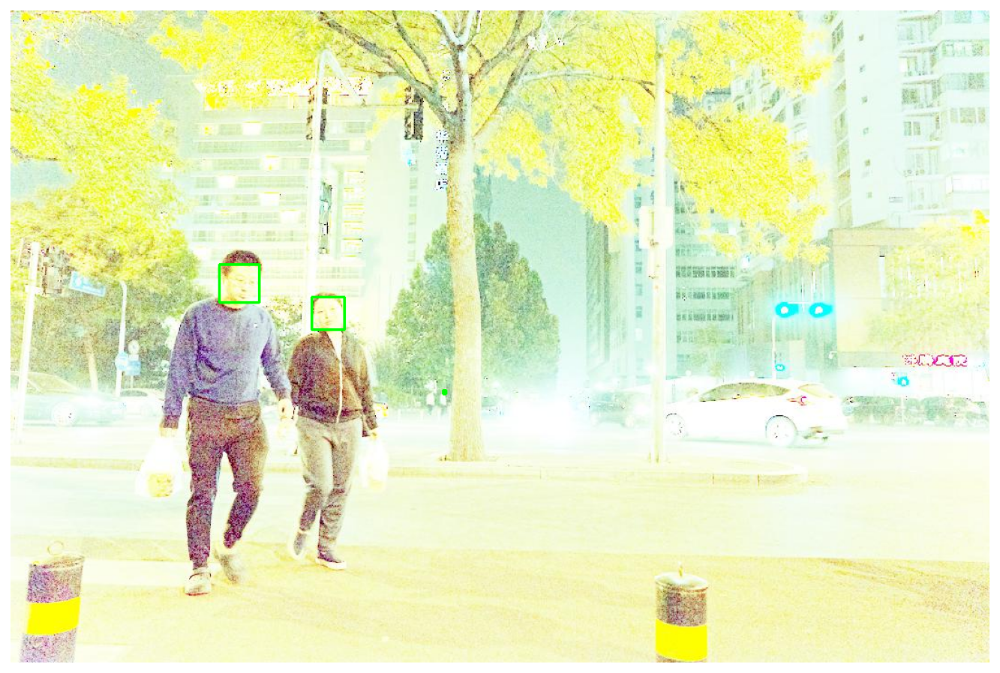

In [49]:
img_df = df[df.file_name == df.file_name.unique()[0]]
print(img_df)
img = annotate_image(img_df, resize=False)

plt.imshow(img)
plt.axis('off');

In [ ]:
img_df = df[df.file_name == df.file_name.unique()[1]]
img = annotate_image(img_df, resize=False)

plt.imshow(img)
plt.axis('off');

Those are good ones, the annotations are clearly visible. We can use torchvision to create a grid of images. Note that the images are in various sizes, so we'll resize them:

In [ ]:
sample_images = [annotate_image(df[df.file_name == f]) for f in df.file_name.unique()[:10]]
sample_images = torch.as_tensor(sample_images)

In [ ]:
sample_images.shape

In [ ]:
sample_images = sample_images.permute(0, 3, 1, 2)

In [ ]:
sample_images.shape

In [ ]:
plt.figure(figsize=(24, 12))
grid_img = torchvision.utils.make_grid(sample_images, nrow=5)

plt.imshow(grid_img.permute(1, 2, 0))
plt.axis('off');

You can clearly see that some annotations are missing (column 4). That's real life data for you, sometimes you have to deal with it in some way.

## Face Detection with Detectron 2

It is time to go through the steps of fine-tuning a model using a custom dataset. But first, let's save 5% of the data for testing:

In [ ]:
df = pd.read_csv('annotations.csv')

IMAGES_PATH = f'faces'

unique_files = df.file_name.unique()

train_files = set(np.random.choice(unique_files, int(len(unique_files) * 0.95), replace=False))
train_df = df[df.file_name.isin(train_files)]
test_df = df[~df.file_name.isin(train_files)]

train_df.head()

The classical train_test_split won't work here, cause we want a split amongst the file names. 

The next parts are written in a bit more generic way. Obviously, we have a single class - face. But adding more should be as simple as adding more annotations to the dataframe:

In [ ]:
classes = df.class_name.unique().tolist()

Next, we'll write a function that converts our dataset into a format that is used by Detectron2:

In [ ]:
def create_dataset_dicts(df, classes):
  dataset_dicts = []
  for image_id, img_name in enumerate(df.file_name.unique()):

    record = {}

    image_df = df[df.file_name == img_name]

    file_path = f'{IMAGES_PATH}/{img_name}'
    record["file_name"] = file_path
    record["image_id"] = image_id
    record["height"] = int(image_df.iloc[0].height)
    record["width"] = int(image_df.iloc[0].width)

    objs = []
    for _, row in image_df.iterrows():

      xmin = int(row.x_min)
      ymin = int(row.y_min)
      xmax = int(row.x_max)
      ymax = int(row.y_max)

      poly = [
          (xmin, ymin), (xmax, ymin), 
          (xmax, ymax), (xmin, ymax)
      ]
      poly = list(itertools.chain.from_iterable(poly))

      obj = {
        "bbox": [xmin, ymin, xmax, ymax],
        "bbox_mode": BoxMode.XYXY_ABS,
        "segmentation": [poly],
        "category_id": classes.index(row.class_name),
        "iscrowd": 0
      }
      objs.append(obj)

    record["annotations"] = objs
    dataset_dicts.append(record)
  return dataset_dicts

We convert every annotation row to a single record with a list of annotations. You might also notice that we're building a polygon that is of the exact same shape as the bounding box. This is required for the image segmentation models in Detectron2.

You'll have to register your dataset into the dataset and metadata catalogues:

In [ ]:
for d in ["train", "val"]:
  DatasetCatalog.register("faces_" + d, lambda d=d: create_dataset_dicts(train_df if d == "train" else test_df, classes))
  MetadataCatalog.get("faces_" + d).set(thing_classes=classes)

statement_metadata = MetadataCatalog.get("faces_train")

Unfortunately, evaluator for the test set is not included by default. We can easily fix that by writing our own trainer:

In [ ]:
class CocoTrainer(DefaultTrainer):
  
  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

The evaluation results will be stored in the `coco_eval` folder if no folder is provided.

Fine-tuning a Detectron2 model is nothing like writing PyTorch code. We'll load a configuration file, change a few values, and start the training process. But hey, it really helps if you know what you're doing 😂

For this tutorial, we'll use the Mask R-CNN X101-FPN model. It is pre-trained on the [COCO dataset](http://cocodataset.org/#home) and achieves very good performance. The downside is that it is slow to train.

Let's load the config file and the pre-trained model weights:

In [ ]:
cfg = get_cfg()

cfg.merge_from_file(
  model_zoo.get_config_file(
    "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
  )
)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(
  "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
)

Specify the datasets (we registered those) we'll use for training and evaluation:

In [ ]:
cfg.DATASETS.TRAIN = ("faces_train",)
cfg.DATASETS.TEST = ("faces_val",)
cfg.DATALOADER.NUM_WORKERS = 4

And for the optimizer, we'll do a bit of magic to converge to something nice:

In [ ]:
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500
cfg.SOLVER.STEPS = (1000, 1499)
cfg.SOLVER.GAMMA = 0.05
cfg.SOLVER.CHECKPOINT_PERIOD = 500

Except for the standard stuff (batch size, max number of iterations, and learning rate) we have a couple of interesting params:

- `WARMUP_ITERS` - the learning rate starts from 0 and goes to the preset one for this number of iterations
- `STEPS` - the checkpoints (number of iterations) at which the learning rate will be reduced by `GAMMA`

Finally, we'll specify the number of classes and the period at which we'll evaluate on the test set:

In [ ]:
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(classes)

cfg.TEST.EVAL_PERIOD = 500

Time to train, using our custom trainer:

In [32]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = CocoTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[11/29 14:48:16 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
model_final_2d9806.pkl: 431MB [00:06, 65.2MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[11/29 14:48:45 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2894.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[11/29 14:50:21 d2.utils.events]:  eta: 1:47:57  iter: 19  total_loss: 3.11  loss_cls: 0.5984  loss_box_reg: 0.07006  loss_mask: 0.691  loss_rpn_cls: 0.3752  loss_rpn_loc: 1.139  time: 4.3197  data_time: 0.0511  lr: 1.931e-06  max_mem: 10351M
[11/29 14:51:56 d2.utils.events]:  eta: 1:51:13  iter: 39  total_loss: 2.98  loss_cls: 0.5887  loss_box_reg: 0.104  loss_mask: 0.6877  loss_rpn_cls: 0.4452  loss_rpn_loc: 1.022  time: 4.5361  data_time: 0.0219  lr: 2.911e-06  max_mem: 10351M
[11/29 14:53:30 d2.utils.events]:  eta: 1:49:30  iter: 59  total_loss: 3.483  loss_cls: 0.5811  loss_box_reg: 0.114  loss_mask: 0.6821  loss_rpn_cls: 0.9647  loss_rpn_loc: 1.065  time: 4.5857  data_time: 0.0140  lr: 3.891e-06  max_mem: 10351M
[11/29 14:55:06 d2.utils.events]:  eta: 1:51:47  iter: 79  total_loss: 2.785  loss_cls: 0.5805  loss_box_reg: 0.1447  loss_mask: 0.6761  loss_rpn_cls: 0.2676  loss_rpn_loc: 0.9982  time: 4.6385  data_time: 0.0165  lr: 4.871e-06  max_mem: 10351M
[11/29 14:56:40 d2.utils.ev

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[11/29 15:27:53 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[11/29 15:27:53 d2.data.datasets.coco]: Conversion finished, #images: 200, #annotations: 1774
[11/29 15:27:53 d2.data.datasets.coco]: Caching COCO format annotations at 'coco_eval/faces_val_coco_format.json' ...
[11/29 15:27:53 d2.evaluation.evaluator]: Start inference on 200 batches
[11/29 15:28:00 d2.evaluation.evaluator]: Inference done 11/200. Dataloading: 0.0015 s/iter. Inference: 0.3153 s/iter. Eval: 0.2084 s/iter. Total: 0.5252 s/iter. ETA=0:01:39
[11/29 15:28:05 d2.evaluation.evaluator]: Inference done 21/200. Dataloading: 0.0020 s/iter. Inference: 0.3149 s/iter. Eval: 0.2069 s/iter. Total: 0.5240 s/iter. ETA=0:01:33
[11/29 15:28:10 d2.evaluation.evaluator]: Inference done 30/200. Dataloading: 0.0022 s/iter. Inference: 0.3154 s/iter. Eval: 0.2182 s/iter. Total: 0.5360 s/iter. ETA=0:01:31
[11/29 15:28:15 d2.evaluation.evaluator]: Inference done 40/200. Dataloading: 0.0023 s/iter. Inference: 0.3159 

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[11/29 16:08:42 d2.evaluation.evaluator]: Inference done 11/200. Dataloading: 0.0014 s/iter. Inference: 0.3149 s/iter. Eval: 0.2135 s/iter. Total: 0.5298 s/iter. ETA=0:01:40
[11/29 16:08:47 d2.evaluation.evaluator]: Inference done 21/200. Dataloading: 0.0023 s/iter. Inference: 0.3151 s/iter. Eval: 0.2102 s/iter. Total: 0.5278 s/iter. ETA=0:01:34
[11/29 16:08:53 d2.evaluation.evaluator]: Inference done 31/200. Dataloading: 0.0028 s/iter. Inference: 0.3157 s/iter. Eval: 0.2080 s/iter. Total: 0.5266 s/iter. ETA=0:01:29
[11/29 16:08:58 d2.evaluation.evaluator]: Inference done 41/200. Dataloading: 0.0027 s/iter. Inference: 0.3162 s/iter. Eval: 0.2066 s/iter. Total: 0.5257 s/iter. ETA=0:01:23
[11/29 16:09:03 d2.evaluation.evaluator]: Inference done 51/200. Dataloading: 0.0025 s/iter. Inference: 0.3169 s/iter. Eval: 0.2063 s/iter. Total: 0.5260 s/iter. ETA=0:01:18
[11/29 16:09:09 d2.evaluation.evaluator]: Inference done 61/200. Dataloading: 0.0026 s/iter. Inference: 0.3176 s/iter. Eval: 0.206

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[11/29 16:49:37 d2.evaluation.evaluator]: Inference done 11/200. Dataloading: 0.0014 s/iter. Inference: 0.3143 s/iter. Eval: 0.2247 s/iter. Total: 0.5404 s/iter. ETA=0:01:42
[11/29 16:49:42 d2.evaluation.evaluator]: Inference done 21/200. Dataloading: 0.0017 s/iter. Inference: 0.3143 s/iter. Eval: 0.2244 s/iter. Total: 0.5407 s/iter. ETA=0:01:36
[11/29 16:49:48 d2.evaluation.evaluator]: Inference done 31/200. Dataloading: 0.0019 s/iter. Inference: 0.3148 s/iter. Eval: 0.2254 s/iter. Total: 0.5423 s/iter. ETA=0:01:31
[11/29 16:49:53 d2.evaluation.evaluator]: Inference done 41/200. Dataloading: 0.0022 s/iter. Inference: 0.3153 s/iter. Eval: 0.2249 s/iter. Total: 0.5426 s/iter. ETA=0:01:26
[11/29 16:49:58 d2.evaluation.evaluator]: Inference done 51/200. Dataloading: 0.0022 s/iter. Inference: 0.3163 s/iter. Eval: 0.2247 s/iter. Total: 0.5433 s/iter. ETA=0:01:20
[11/29 16:50:04 d2.evaluation.evaluator]: Inference done 61/200. Dataloading: 0.0023 s/iter. Inference: 0.3174 s/iter. Eval: 0.224

## Evaluating Object Detection Models

Evaluating object detection models is a bit different when compared to evaluating standard classification or regression models.

The main metric you need to know about is IoU (intersection over union). It measures the overlap between two boundaries - the predicted and ground truth one. It can get values between 0 and 1.

$$\text{IoU}=\frac{\text{area of overlap}}{\text{area of union}}$$

Using IoU, one can define a threshold (e.g. >0.5) to classify whether a prediction is a true positive (TP) or a false positive (FP).

Now you can calculate average precision (AP) by taking the area under the precision-recall curve.

Now AP@X (e.g. AP50) is just AP at some IoU threshold. This should give you a working understanding of how object detection models are evaluated.

I suggest you read the [mAP (mean Average Precision) for Object Detection](https://medium.com/@jonathan_hui/map-mean-average-precision-for-object-detection-45c121a31173) tutorial by Jonathan Hui if you want to learn more on the topic.

In [38]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [39]:
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 7649), started 0:01:31 ago. (Use '!kill 7649' to kill it.)

<IPython.core.display.Javascript object>

I've prepared a pre-trained model for you, so you don't have to wait for the training to complete. Let's download it:

In [ ]:
!gdown --id 18Ev2bpdKsBaDufhVKf0cT6RmM3FjW3nL
!mv face_detector.pth output/model_final.pth

We can start making predictions by loading the model and setting a minimum threshold of 85% certainty at which we'll consider the predictions as correct:

In [40]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)

[11/29 16:54:10 d2.checkpoint.c2_model_loading]: Following weights matched with model:
| Names in Model                                  | Names in Checkpoint                                                                                  | Shapes                                          |
|:------------------------------------------------|:-----------------------------------------------------------------------------------------------------|:------------------------------------------------|
| backbone.bottom_up.res2.0.conv1.*               | backbone.bottom_up.res2.0.conv1.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (256,) (256,) (256,) (256,) (256,64,1,1)        |
| backbone.bottom_up.res2.0.conv2.*               | backbone.bottom_up.res2.0.conv2.{norm.bias,norm.running_mean,norm.running_var,norm.weight,weight}    | (256,) (256,) (256,) (256,) (256,8,3,3)         |
| backbone.bottom_up.res2.0.conv3.*               | backbone.bottom_up.res2.0.conv3.{norm.bia

Let's run the evaluator with the trained model:

In [41]:
evaluator = COCOEvaluator("faces_val", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "faces_val")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [11/29 16:54:19 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[11/29 16:54:19 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[11/29 16:54:19 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common.NumpySerializedList'>
[11/29 16:54:19 d2.data.common]: Serializing 200 elements to byte tensors and concatenating them all ...
[11/29 16:54:19 d2.data.common]: Serialized dataset takes 0.15 MiB
[11/29 16:54:19 d2.evaluation.evaluator]: Start inference on 200 batches


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[11/29 16:54:26 d2.evaluation.evaluator]: Inference done 11/200. Dataloading: 0.0036 s/iter. Inference: 0.3091 s/iter. Eval: 0.1925 s/iter. Total: 0.5052 s/iter. ETA=0:01:35
[11/29 16:54:31 d2.evaluation.evaluator]: Inference done 21/200. Dataloading: 0.0031 s/iter. Inference: 0.3095 s/iter. Eval: 0.1899 s/iter. Total: 0.5026 s/iter. ETA=0:01:29
[11/29 16:54:36 d2.evaluation.evaluator]: Inference done 31/200. Dataloading: 0.0030 s/iter. Inference: 0.3101 s/iter. Eval: 0.1899 s/iter. Total: 0.5032 s/iter. ETA=0:01:25
[11/29 16:54:41 d2.evaluation.evaluator]: Inference done 41/200. Dataloading: 0.0030 s/iter. Inference: 0.3109 s/iter. Eval: 0.1904 s/iter. Total: 0.5046 s/iter. ETA=0:01:20
[11/29 16:54:46 d2.evaluation.evaluator]: Inference done 51/200. Dataloading: 0.0028 s/iter. Inference: 0.3113 s/iter. Eval: 0.1910 s/iter. Total: 0.5054 s/iter. ETA=0:01:15
[11/29 16:54:51 d2.evaluation.evaluator]: Inference done 61/200. Dataloading: 0.0028 s/iter. Inference: 0.3125 s/iter. Eval: 0.190

OrderedDict([('bbox',
              {'AP': 7.616099726812098,
               'AP50': 25.268262812006697,
               'AP75': 2.2692296297353662,
               'APs': 7.121221017931538,
               'APm': 16.12417267031521,
               'APl': 5.0495049504950495}),
             ('segm',
              {'AP': 7.5724662860051515,
               'AP50': 25.57215078592016,
               'AP75': 1.9399865161629959,
               'APs': 7.077173786164015,
               'APm': 16.04070103893255,
               'APl': 5.0495049504950495})])

### Finding Faces in Images

Next, let's create a folder and save all images with predicted annotations in the test set:

In [42]:
os.makedirs("annotated_results", exist_ok=True)

test_image_paths = test_df.file_name.unique()

In [50]:
for clothing_image in test_image_paths:
  file_path = f'{IMAGES_PATH}/{clothing_image}'
  im = cv2.imread(file_path)
  outputs = predictor(im)
  v = Visualizer(
    im[:, :, ::-1],
    metadata=statement_metadata, 
    scale=1., 
    instance_mode=ColorMode.IMAGE
  )
  instances = outputs["instances"].to("cpu")
  #instances.remove('pred_masks')
  v = v.draw_instance_predictions(instances)
  result = v.get_image()[:, :, ::-1]
  file_name = ntpath.basename(clothing_image)
  write_res = cv2.imwrite(f'annotated_results/{file_name}', result)

Let's have a look:

In [51]:
annotated_images = [f'annotated_results/{f}' for f in test_df.file_name.unique()]

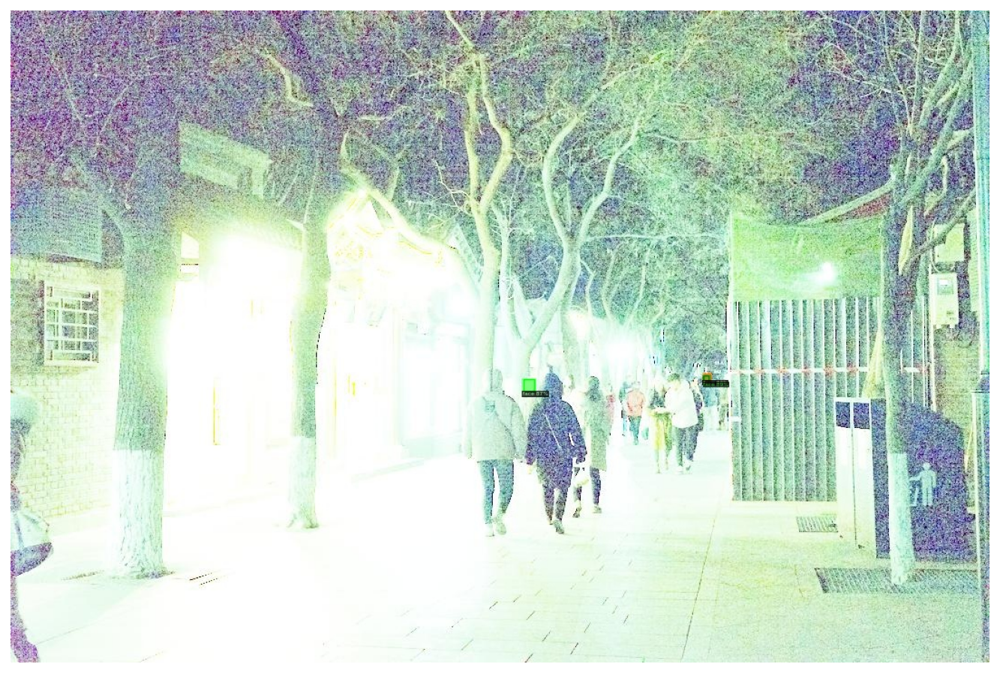

In [52]:
img = cv2.cvtColor(cv2.imread(annotated_images[0]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

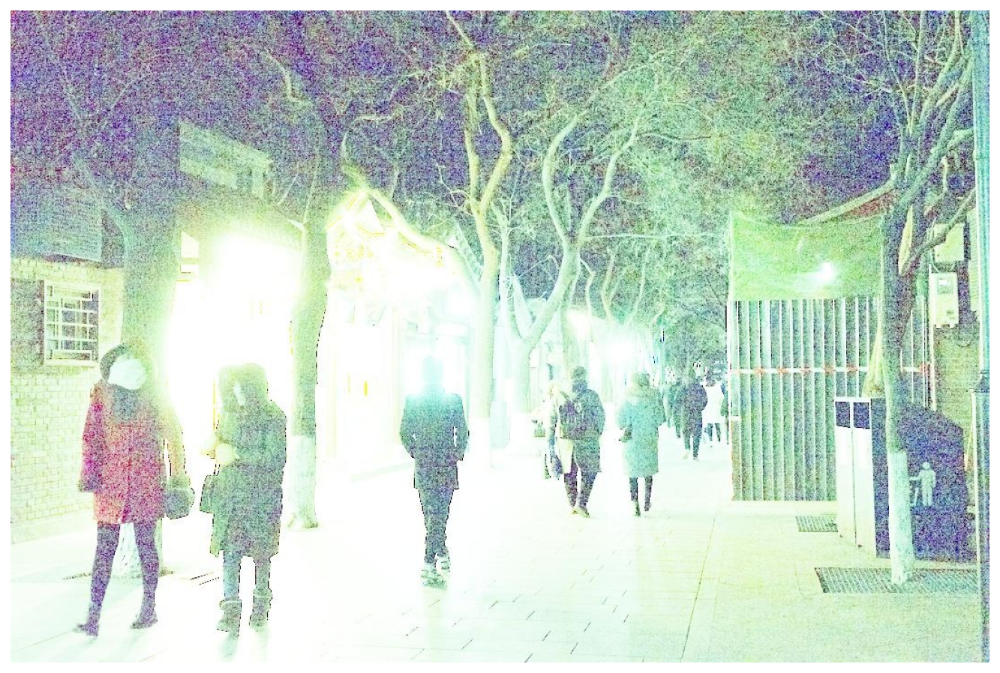

In [53]:
img = cv2.cvtColor(cv2.imread(annotated_images[1]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

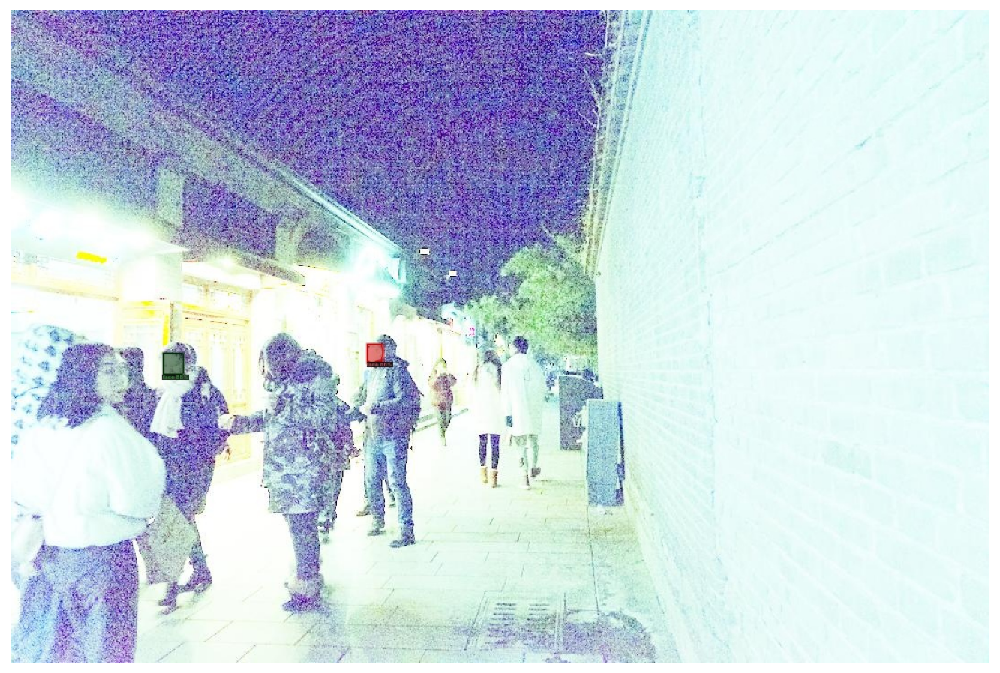

In [54]:
img = cv2.cvtColor(cv2.imread(annotated_images[3]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');

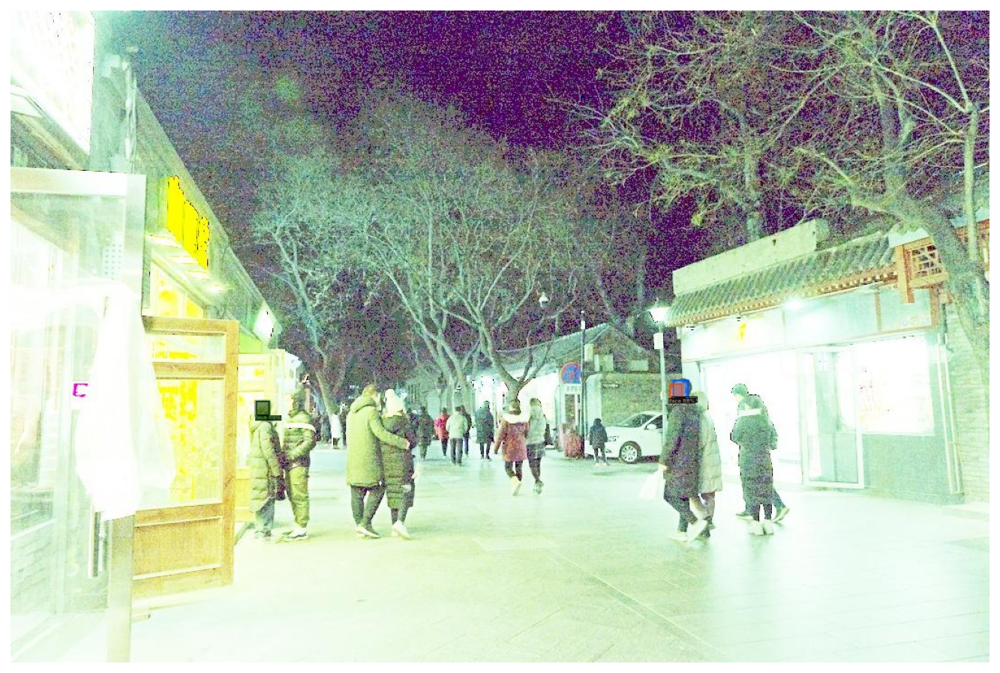

In [55]:
img = cv2.cvtColor(cv2.imread(annotated_images[4]), cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis('off');